In [8]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import numpy as np
from lets_plot import *
LetsPlot.setup_html()

In [65]:
data = 'gapminder_full.csv'
df = pd.read_csv(data)
df.head()

,country,year,population,continent,life_exp,gdp_cap
0,Afghanistan,1952,8425333,Asia,28.801,779.445314
1,Afghanistan,1957,9240934,Asia,30.332,820.853030
2,Afghanistan,1962,10267083,Asia,31.997,853.100710
3,Afghanistan,1967,11537966,Asia,34.020,836.197138
4,Afghanistan,1972,13079460,Asia,36.088,739.981106


In [66]:
df.corr()

/var/folders/q8/mbpwcdsj0ngfw0vpfscwqg4h0000gn/T/ipykernel_49650/1134722465.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  df.corr()


,year,population,life_exp,gdp_cap
year,1.000000,0.082308,0.435611,0.227318
population,0.082308,1.000000,0.064955,-0.025600
life_exp,0.435611,0.064955,1.000000,0.583706
gdp_cap,0.227318,-0.025600,0.583706,1.000000


/var/folders/q8/mbpwcdsj0ngfw0vpfscwqg4h0000gn/T/ipykernel_49650/221941791.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr(), annot=True)


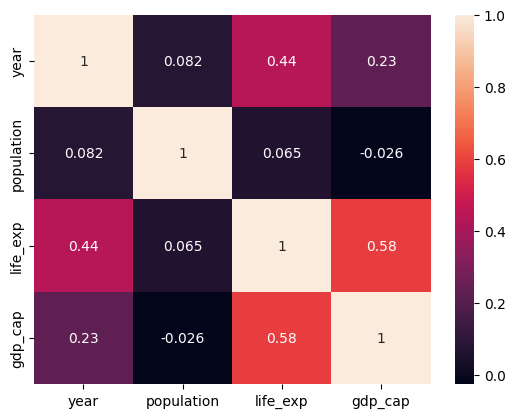

In [55]:
sns.heatmap(df.corr(), annot=True)
plt.show()

In [50]:
data = df.corr().reset_index()

/var/folders/q8/mbpwcdsj0ngfw0vpfscwqg4h0000gn/T/ipykernel_49650/2570117235.py:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data = df.corr().reset_index()


In [51]:
from lets_plot.bistro.corr import *

In [64]:
plot = corr_plot(data, flip = False, threshold = 0.0, show_legend= False).points().tiles().labels().build() + theme_classic() + flavor_high_contrast_dark() + ggtitle(''' ''') + ggsize(1366, 700)

ggsave(plot, 'corrplot.png', path='.', iframe=False)

'/Users/patrick/Desktop/Lighthouse_labs/Lighthouse-data-notes/RnR/corrplot.png'

In [48]:
# bar plot of year vs life expectancy
p = ggplot(df, aes(x='year', y='gdp_cap', group = 'continent')) + geom_point(size = 5, stat='identity', position='identity')
p = p + ggtitle('Gdp per capita by continent') + xlab('Year') + ylab('Gdp per capita')+ scale_fill_brewer(palette='YlGnBu')
p = p + scale_fill_discrete()

p

In [72]:
p = ggplot(df, aes(x = 'gdp_cap', y='life_exp', colour = 'country', size = 'population',)) + \
    geom_point(alpha = 0.9, show_legend= False, stat= 'identity') + \
        scale_size(range = [2, 25]) + \
            scale_viridis(aesthetic=['color', 'fill'], option='D') + \
            theme_classic() + \
            flavor_high_contrast_dark() + \
            scale_x_log10() + \
            labs(title = ' ', x = 'GDP per capita', y = 'Life expectancy') +\
             ggsize(1200, 800)

ggsave(p, 'life_exp.html', path='.', iframe=False)

'/Users/patrick/Desktop/Lighthouse_labs/Lighthouse-data-notes/RnR/life_exp.html'

In [79]:
# correlation plot of df using ggplot
def ggplot1(df):
    p = ggplot(df, aes(x='gdp_cap', y='life_exp', color='continent', size = 'population')) + geom_point(alpha=0.9,show_legend= False, stat= 'identity') + \
        scale_color_viridis(option='A', direction=-1) + \
        scale_size(range = [2, 15]) + \
        ggtitle('Correlation between GDP per capita and life expectancy') + \
            theme_classic() + \
                flavor_high_contrast_dark() + \
                scale_x_log10() + \
        xlab('GDP per capita') + ylab('Life expectancy') + \
        ggsize(1200, 800)
    return p
# save to html
#ggsave(p, 'correlation.html')

In [6]:
ggplot1(df)

In [97]:
p = ggplot(df, aes(y = 'population', x = 'year', group = 'continent', fill = 'continent')) + geom_smooth(alpha = 1, show_legend= True) + \
    scale_color_viridis(option='A', direction=-1) + \
    theme_classic() + \
    flavor_high_contrast_dark() + \
    labs(title = ' ', x = 'Life expectancy', y = 'Density') +\
    ggsize(1200, 800)
p

In [ ]:
# generate frames 

for i in range (1952, 2008, 2):
    df1 = df[df['year'] == i]
    p = ggplot1(df1)
    ggsave(p, 'correlation' + str(i) + '.png')

OSError: no library called "cairo-2" was found
no library called "cairo" was found
no library called "libcairo-2" was found
cannot load library 'libcairo.so.2': dlopen(libcairo.so.2, 0x0002): tried: '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/python3.9/site-packages/../../libcairo.so.2' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/libcairo.so.2' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/bin/../lib/libcairo.so.2' (no such file), 'libcairo.so.2' (no such file), '/usr/local/lib/libcairo.so.2' (no such file), '/usr/lib/libcairo.so.2' (no such file), '/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/libcairo.so.2' (no such file)
cannot load library 'libcairo.2.dylib': dlopen(libcairo.2.dylib, 0x0002): tried: '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/python3.9/site-packages/../../libcairo.2.dylib' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/libcairo.2.dylib' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/bin/../lib/libcairo.2.dylib' (no such file), 'libcairo.2.dylib' (no such file), '/usr/local/lib/libcairo.2.dylib' (no such file), '/usr/lib/libcairo.2.dylib' (no such file), '/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/libcairo.2.dylib' (no such file)
cannot load library 'libcairo-2.dll': dlopen(libcairo-2.dll, 0x0002): tried: '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/python3.9/site-packages/../../libcairo-2.dll' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/lib/libcairo-2.dll' (no such file), '/Users/patrickokwir/miniconda/envs/DeepLearning/bin/../lib/libcairo-2.dll' (no such file), 'libcairo-2.dll' (no such file), '/usr/local/lib/libcairo-2.dll' (no such file), '/usr/lib/libcairo-2.dll' (no such file), '/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/libcairo-2.dll' (no such file)

In [ ]:
import imageio
import os

In [ ]:
# create gif from svg files
path = '/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/lets-plot-images/'
files = os.listdir(path)
files = [f for f in files if f.endswith('.svg')]

with imageio.get_writer('line.gif', mode='i') as writer:
    for filename in files:
        image = imageio.imread(path + filename)
        writer.append_data(image)
        print(filename)
    writer.close()
    print('done')

    

/var/folders/7f/4z7lvktj44g121hm_1s6v18h0000gn/T/ipykernel_19878/3275331142.py:8: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(path + filename)


ValueError: Could not find a backend to open `/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/lets-plot-images/correlation1984.svg`` with iomode `ri`.

In [ ]:
path = '/Users/patrickokwir/Desktop/Lighthouse-data-notes/RnR/lets-plot-images/'

In [ ]:
create_gif()

ValueError: need at least one array to stack

In [11]:
df.head()

,country,year,population,continent,life_exp,gdp_cap
0,Afghanistan,1952,8425333,Asia,28.801,779.445314
1,Afghanistan,1957,9240934,Asia,30.332,820.853030
2,Afghanistan,1962,10267083,Asia,31.997,853.100710
3,Afghanistan,1967,11537966,Asia,34.020,836.197138
4,Afghanistan,1972,13079460,Asia,36.088,739.981106


In [12]:
import pandas as pd
from IPython.display import display
import geopandas as gpd
from lets_plot import *
from lets_plot.geo_data import *
LetsPlot.setup_html()

The geodata is provided by © OpenStreetMap contributors and is made available here under the Open Database License (ODbL).


In [13]:
world = geocode_countries('world')

In [ ]:
print(world)

In [14]:
countries = geocode_countries().inc_res().get_boundaries()
display(countries)
ggplot() + geom_map(aes(fill='found name'), data=countries, color='white', show_legend= False) + ggsize(1280, 800) + theme_classic() + flavor_high_contrast_dark()

,country,found name,geometry
0,Andorra,Andorra,"MULTIPOLYGON (((1.75781 42.55308, 1.58203 42.5..."
1,Slovensko,Slovensko,"MULTIPOLYGON (((17.22656 47.98992, 17.05078 47..."
2,Österreich,Österreich,"MULTIPOLYGON (((10.54688 47.51720, 10.37109 47..."
3,Magyarország,Magyarország,"MULTIPOLYGON (((22.85156 47.98992, 22.85156 47..."
4,საქართველო,საქართველო,"MULTIPOLYGON (((46.23047 41.64008, 46.40625 41..."
...,...,...,...
213,Tchad تشاد,Tchad تشاد,"MULTIPOLYGON (((14.94141 12.38293, 14.76562 12..."
214,Bosna i Hercegovina / Босна и Херцеговина,Bosna i Hercegovina / Босна и Херцеговина,"MULTIPOLYGON (((17.75391 42.94034, 17.75391 43..."
215,Norge,Norge,"MULTIPOLYGON (((21.09375 78.66461, 20.91797 78..."
216,Maroc / ⵍⵎⵖⵔⵉⴱ / المغرب,Maroc / ⵍⵎⵖⵔⵉⴱ / المغرب,"MULTIPOLYGON (((-15.99609 23.56399, -15.99609 ..."


In [19]:
countries.head()

,country,found name,geometry
0,Andorra,Andorra,"MULTIPOLYGON (((1.75781 42.55308, 1.58203 42.5..."
1,Slovensko,Slovensko,"MULTIPOLYGON (((17.22656 47.98992, 17.05078 47..."
2,Österreich,Österreich,"MULTIPOLYGON (((10.54688 47.51720, 10.37109 47..."
3,Magyarország,Magyarország,"MULTIPOLYGON (((22.85156 47.98992, 22.85156 47..."
4,საქართველო,საქართველო,"MULTIPOLYGON (((46.23047 41.64008, 46.40625 41..."


In [37]:
# merge countries and df full outter join
df1 = pd.merge(countries, df, how='outer', left_on='found name', right_on='country')
df1.head()

,country_x,found name,geometry,country_y,year,population,continent,life_exp,gdp_cap
0,Andorra,Andorra,"MULTIPOLYGON (((1.75781 42.55308, 1.58203 42.5...",NaN,NaN,NaN,NaN,NaN,NaN
1,Slovensko,Slovensko,"MULTIPOLYGON (((17.22656 47.98992, 17.05078 47...",NaN,NaN,NaN,NaN,NaN,NaN
2,Österreich,Österreich,"MULTIPOLYGON (((10.54688 47.51720, 10.37109 47...",NaN,NaN,NaN,NaN,NaN,NaN
3,Magyarország,Magyarország,"MULTIPOLYGON (((22.85156 47.98992, 22.85156 47...",NaN,NaN,NaN,NaN,NaN,NaN
4,საქართველო,საქართველო,"MULTIPOLYGON (((46.23047 41.64008, 46.40625 41...",NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
# plot life expectancy by country
ggplot() + geom_map(aes(fill='found name'), data=df1, color='white', show_legend= False) + ggsize(1280, 800) + theme_classic() + flavor_high_contrast_dark()

In [44]:
countries = geocode_countries(df['country']).inc_res().get_boundaries()

ValueError: No objects were found for Congo, Dem. Rep., Congo, Rep., Cote d'Ivoire, Hong Kong, China, Korea, Dem. Rep., Korea, Rep., Puerto Rico, Reunion, Sao Tome and Principe, Slovak Republic and (2) more.
